https://docs.opencv.org/4.x/d4/dc6/tutorial_py_template_matching.html
I'll use this idea (and tool)

In [1]:
from pathlib import Path

import cv2 as cv
import numpy as np
from matplotlib import pyplot as plt

In [2]:
img_paths = [str(p) for p in Path("../test-task/scraped_examples").iterdir()]
img_paths.sort()

In [3]:
img = cv.cvtColor((cv.imread(img_paths[0])), cv.COLOR_BGR2RGB)

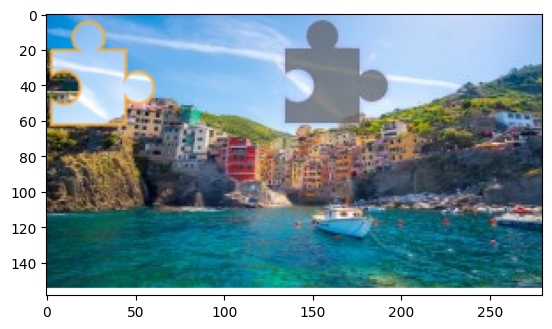

In [4]:
plt.imshow(img)

I cropped the region of interest manually from one of the images where background is both contrastive and monothonic.

In [5]:
template = cv.cvtColor((cv.imread("../test-task/template.png")), cv.COLOR_BGR2RGB)

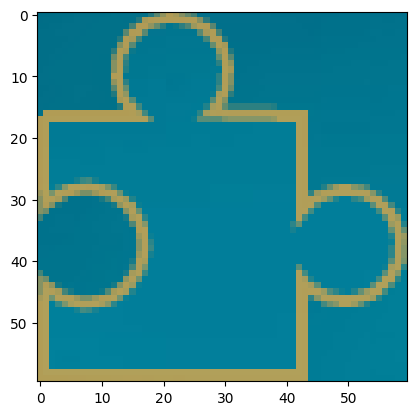

In [6]:
plt.imshow(template)

In [7]:
template[1, 25]

array([177, 156,  86], dtype=uint8)

I extract a binary mask using orange color values. (I iterated several times searching for range until I got enough contours)

In [8]:
low = np.array([150, 140, 80])
high = np.array([200, 160, 90])

In [9]:
mask=cv.inRange(template,low,high)

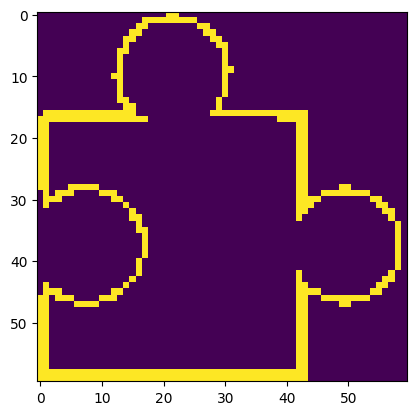

In [10]:
plt.imshow(mask)

In [11]:
def load_puzzle_template_and_mask():
    puzzle_template = cv.cvtColor((cv.imread("../test-task/template.png")), cv.COLOR_BGR2RGB)
    
    low = np.array([150, 140, 80])
    high = np.array([200, 160, 90])
    mask=cv.inRange(template,low,high)
    
    puzzle_template = cv.cvtColor(template, cv.COLOR_RGB2GRAY)
    
    return puzzle_template, mask

In [12]:
def find_fragment(img, fragment, method, mask=None):
    """
    Returns one set of coords with max similarity
    """
    w, h = fragment.shape[::-1]
    res = cv.matchTemplate(img,fragment, method, None, mask)
    *_, top_left = cv.minMaxLoc(res)
    bottom_right = (top_left[0] + w, top_left[1] + h)
    
    return top_left, bottom_right

In [13]:
def find_distance(img, puzzle_coords):
    """
    The idea is to extract ROI from given puzzle fragment and make a search for it with given puzzle masked out
    to find its counterpart, since it has the same content (ROI), but shaded.
    """
    (top_x, top_y), (bottom_x, bottom_y) = puzzle_coords
    # coords choice can be explained with the puzzle image above:
    roi_coords = top_x + 20, top_y + 20, bottom_x - 20, bottom_y - 5
    template = img[roi_coords[1]:roi_coords[3], roi_coords[0]:roi_coords[2]]
    
    masked_img = img.copy()
    masked_img = cv.rectangle(masked_img,*puzzle_coords, 255, -1)
    
    top_left, bottom_right = find_fragment(masked_img, template, cv.TM_CCOEFF_NORMED)
    (x1, _), (_, _) = top_left, bottom_right
    
    # distance is calculated between any pair of xs (original ROI and new found one)
    distance = abs(x1 - roi_coords[0])
    
    return distance
    

/tmp/ipykernel_353821/4186283291.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure()


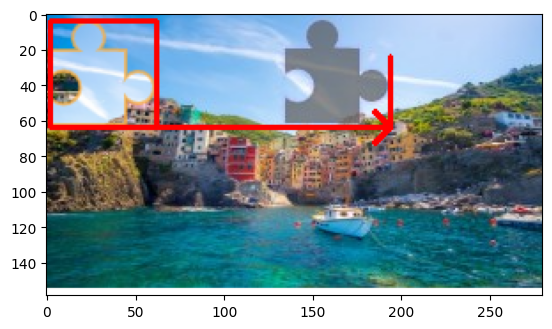

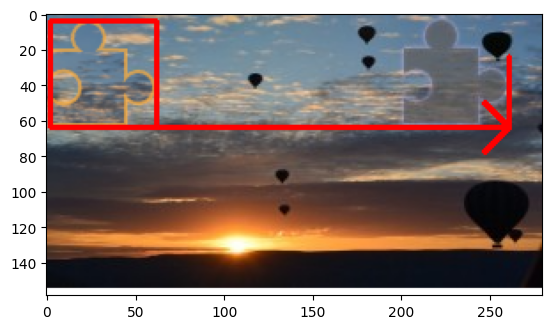

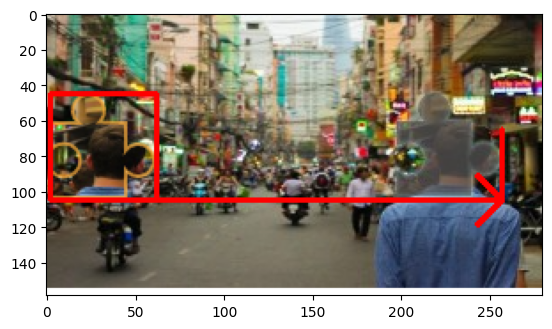

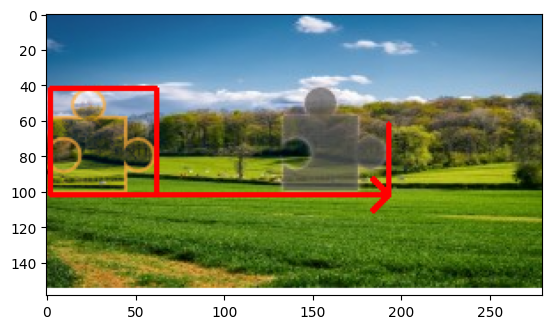

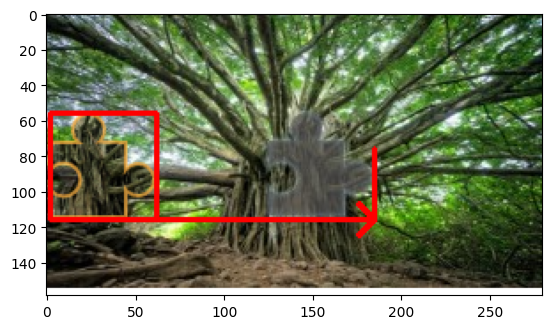

...

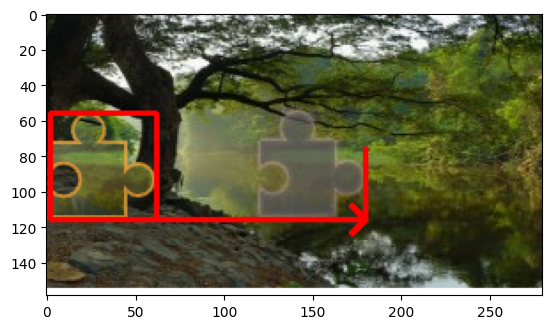

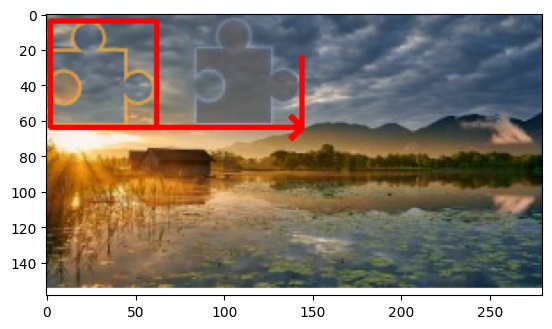

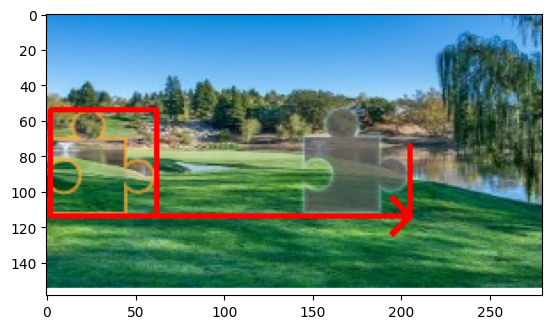

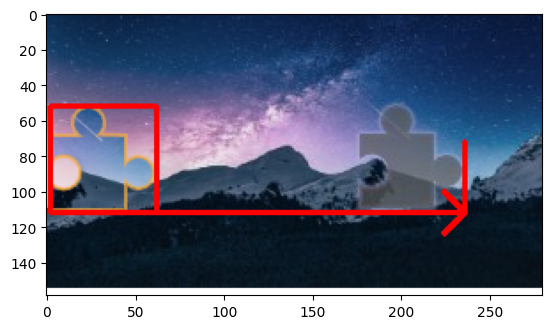

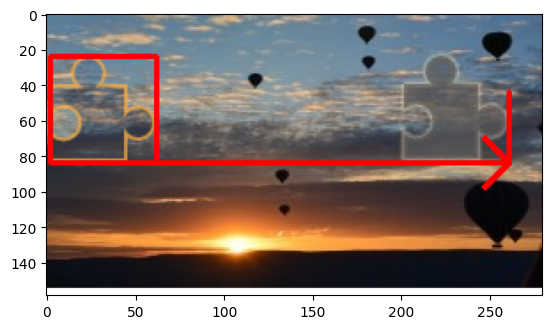

In [14]:
puzzle_template, puzzle_mask = load_puzzle_template_and_mask()
for p in img_paths:
    plt.figure()
    img = cv.imread(p)
    color_img = cv.cvtColor(img, cv.COLOR_BGR2RGB)
    grey_img = cv.cvtColor(img, cv.COLOR_BGR2GRAY)
    
    pz_top_left, pz_bottom_right = find_fragment(grey_img, puzzle_template, cv.TM_CCORR_NORMED, puzzle_mask)
    distance = find_distance(grey_img, (pz_top_left, pz_bottom_right))
    
    # draw frame around puzzle
    cv.rectangle(color_img, pz_top_left, pz_bottom_right, 255, 2)
    
    # horizontal arrow
    arrow_coords = pz_bottom_right[0]+distance, pz_bottom_right[1]
    cv.arrowedLine(color_img, pz_bottom_right, arrow_coords, 255, 2)
    
    # vertical mark
    vert_line_top_coord = arrow_coords[0], arrow_coords[1]-40
    cv.line(color_img, arrow_coords, vert_line_top_coord, 255, 2)
    
    plt.imshow(color_img,cmap = 'gray')


Accuracy is not impressive, and still it covers the majority.
Most of failures are on the first stage (finding orange-lined puzzle), and some are on the second (finding a counterparting shaded puzzle)
It also appeared so that a shaded counterpart is located only to the right, so does the algorithm work.